# Alternative methods for prime factorization using classical resources (revised version)
### The Rock 'n' Roll Institute of Physics and Fine Arts

Lets load some necessary functions

In [18]:
using Base.Threads
include("PhactLib.jl")
using Primes
using Plots
gr()

LoadError: LoadError: ArgumentError: @threads requires a `for` loop expression
in expression starting at /home/jay/Factor/PhactLib.jl:24
in expression starting at /home/jay/Factor/PhactLib.jl:24

To get the feeling of the scheme, we will visualize some cases

In [13]:
# Generates a list of prime numbers
#pr = primes(9999,99999)
#pri = rand(pr,2)
pri = 1119416189, 1000000007

# Product of two prime numbers
N = pri[1]*pri[2]

# Visualization for small N
step = 100000000000
as = 2:step:N-1
rs = 2:step:N-1
G = customGCD.(rs .+ isqrt(N),rs .+ isqrt(N),N)
#G = customGCD.(as,rs',N)
gi = G./G
gi[isnan.(gi)] .= 0.
convert(typeof(G),gi)
println("The big number is $N")
println("Prime numbers are $pri")
println("Probability $(sum(gi)/(length(as))^1)")

The big number is 1119416196835913323
Prime numbers are (1119416189, 1000000007)
Probability 8.933227873600543e-8


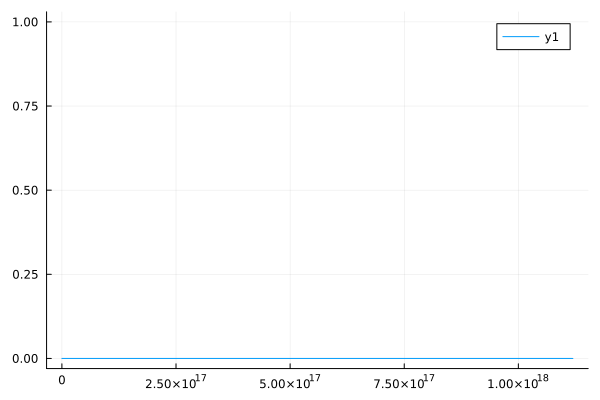

In [14]:
#default(size = (400, 400))
#heatmap(as[1:100:end],rs[1:100:end],G[1:100:end],aspect_ratio=1, colorbar=true, axis=:on)
st=10
plot(rs[1:st:end],gi[1:st:end])

In [15]:
l = length(gi)
mm = zeros((l+1))
mm[1:end-1] = gi;

repp=2
mi = reshape(mm,(:,repp));

mis = sum(mi, dims=2)
Mi = repeat(mis,1,repp)
MM = Mi[:];

DimensionMismatch: DimensionMismatch: array size 11194163 must be divisible by the product of the new dimensions (Colon(), 2)

In [6]:
plot(MM)

UndefVarError: UndefVarError: MM not defined

Using the funny algorithm...

In [17]:
#N = BigInt(3628273133)*BigInt(3367900313)
N = BigInt(118295142164718608911)
# N=BigInt(123456136101521)*BigInt(116666666666611);
@time p,c = FNFfactparalel(N,15)
q = div(N,p)

InterruptException: InterruptException:

In [8]:
println("Big number N = $N")
println("p=$(p), q=$(q)")
println("Number of operations = $(c)")

Big number N = 118295142164718608911
p=11071194311, q=10684948601
Number of operations = 189295064
